<a href="https://colab.research.google.com/github/stevenAnto/cgvcLabs/blob/main/Lab08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Redimensionar imágenes


In [9]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [16]:
!pip install opencv-python

In [17]:
import cv2
from google.colab.patches import cv2_imshow  # Función especial para Colab

In [18]:
img1 = cv2.imread('/content/mairposa.webp')
img2 = cv2.imread('/content/pelicano.jpg')
img3 = cv2.imread('/content/volando.jpeg')
print(f'Tamaño de la imagen 1: {img1.shape}')
print(f'Tamaño de la imagen 2: {img2.shape}')
print(f'Tamaño de la imagen 3: {img3.shape}')

Tamaño de la imagen 1: (1080, 1920, 3)
Tamaño de la imagen 2: (408, 612, 3)
Tamaño de la imagen 3: (168, 300, 3)


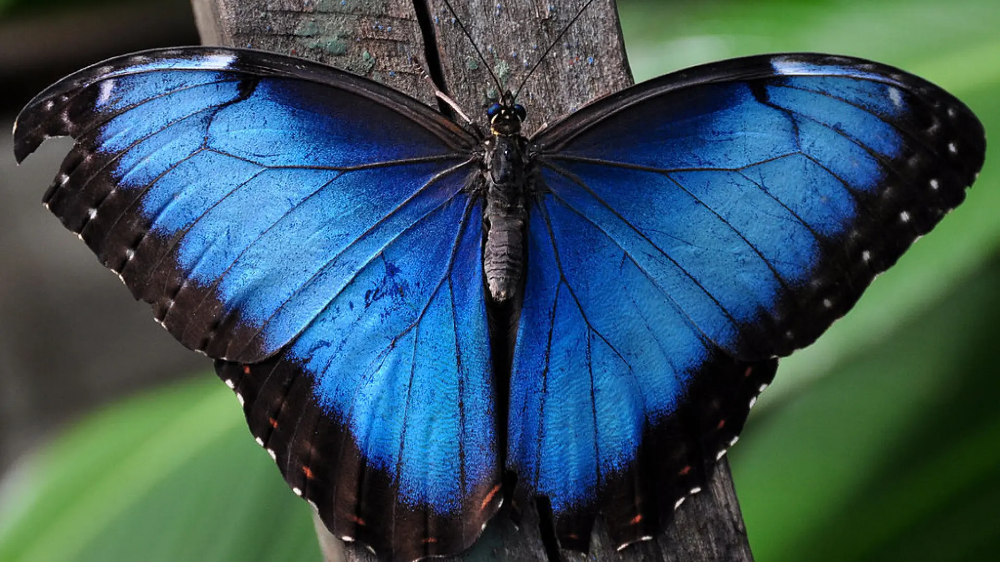

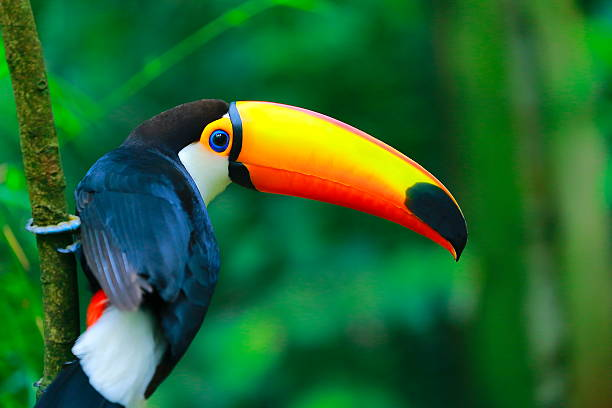

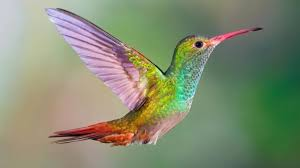

In [21]:
cv2_imshow(img1)
cv2_imshow(img2)
cv2_imshow(img3)


In [5]:
max_height = max(img1.shape[0], img2.shape[0], img3.shape[0])
max_width = max(img1.shape[1], img2.shape[1], img3.shape[1])


In [6]:
resized_img1 = cv2.resize(img1, (max_width, max_height))
resized_img2 = cv2.resize(img2, (max_width, max_height))
resized_img3 = cv2.resize(img3, (max_width, max_height))

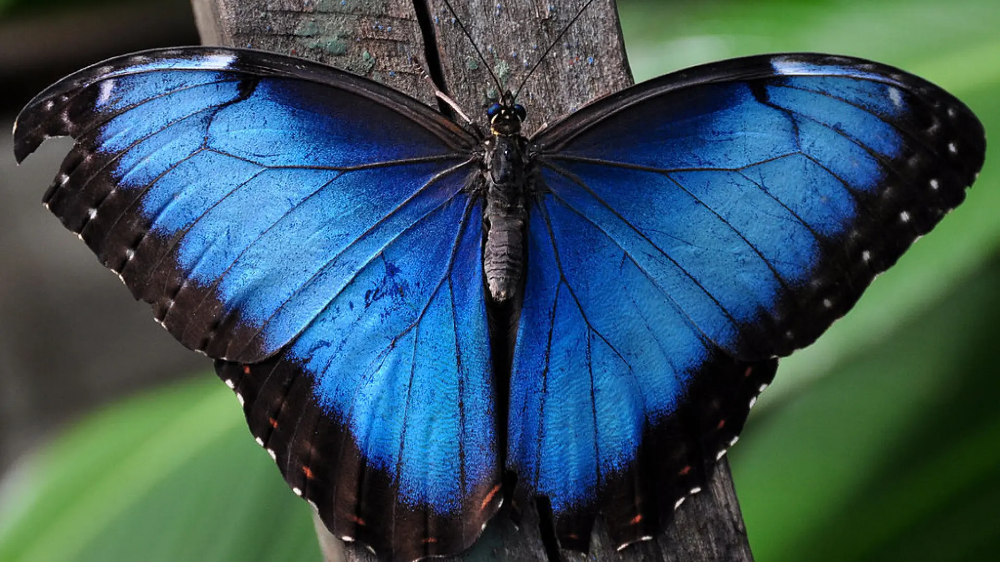

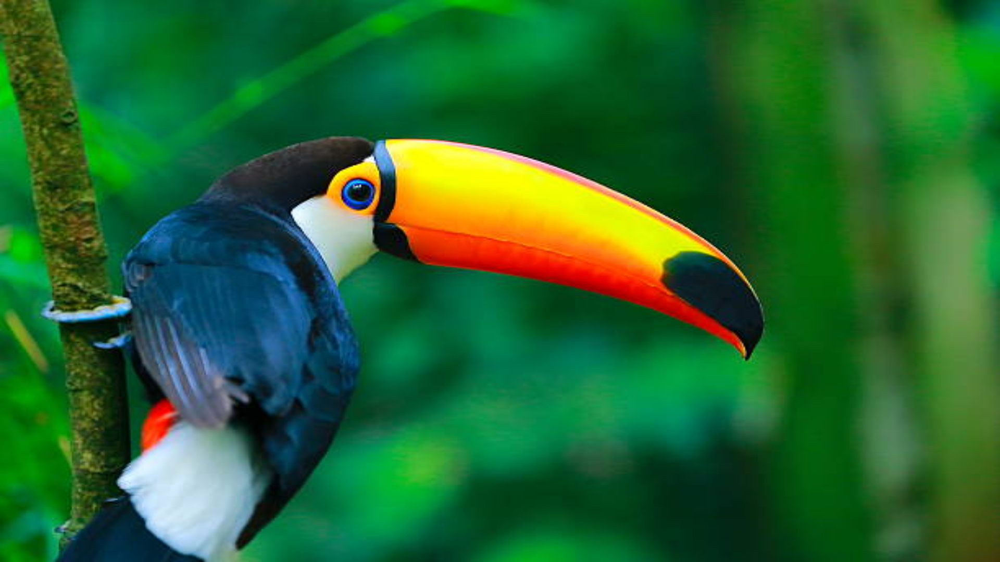

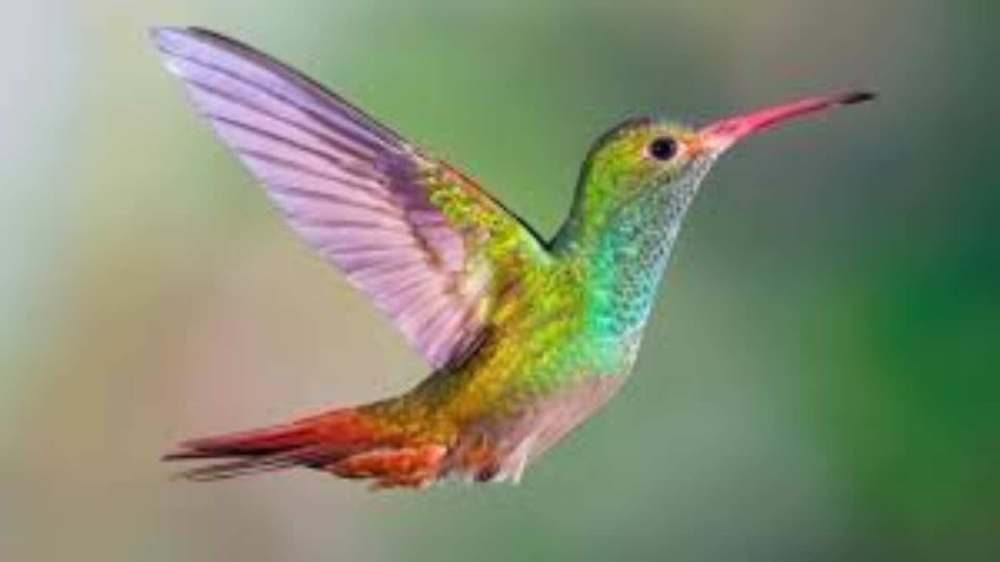

In [23]:
cv2_imshow(resized_img1)
cv2_imshow(resized_img2)
cv2_imshow(resized_img3)


In [24]:
b = img1[:, :, 0]  # Canal Azul
g = img2[:, :, 1]  # Canal Verde
r = img3[:, :, 2]  # Canal Rojo


Imagen con solo el canal ROJO (de img1):


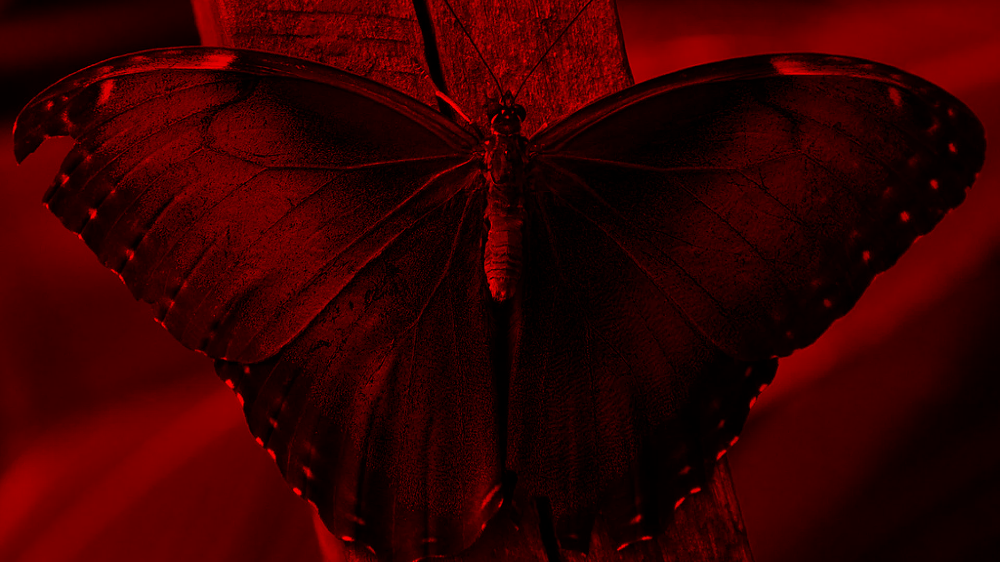

In [26]:
img_rojo = img1.copy()  # Copiar la imagen original
img_rojo[:, :, 0] = 0   # Canal Azul (B) = 0 (apagar)
img_rojo[:, :, 1] = 0   # Canal Verde (G) = 0 (apagar)
print("Imagen con solo el canal ROJO (de img1):")
cv2_imshow(img_rojo)


Imagen con solo el canal VERDE (de img2):


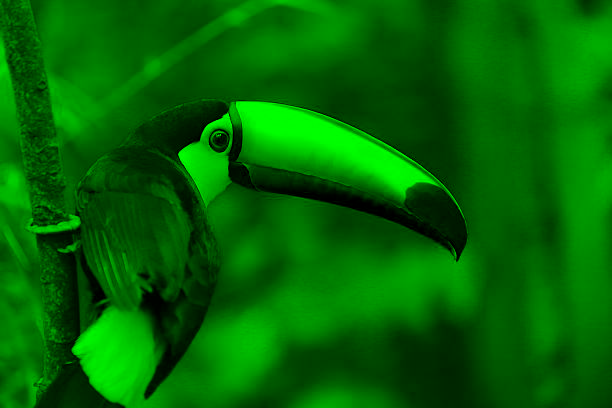

In [27]:
img_verde = img2.copy()
img_verde[:, :, 0] = 0  # Apagar canal B
img_verde[:, :, 2] = 0  # Apagar canal R

print("\nImagen con solo el canal VERDE (de img2):")
cv2_imshow(img_verde)

In [30]:
img_azul = img3.copy()
img_azul[:, :, 1] = 0   # Apagar canal G
img_azul[:, :, 2] = 0   # Apagar canal R


Imagen con solo el canal AZUL (de img3):


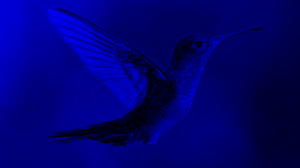

In [31]:

print("\nImagen con solo el canal AZUL (de img3):")
cv2_imshow(img_azul)

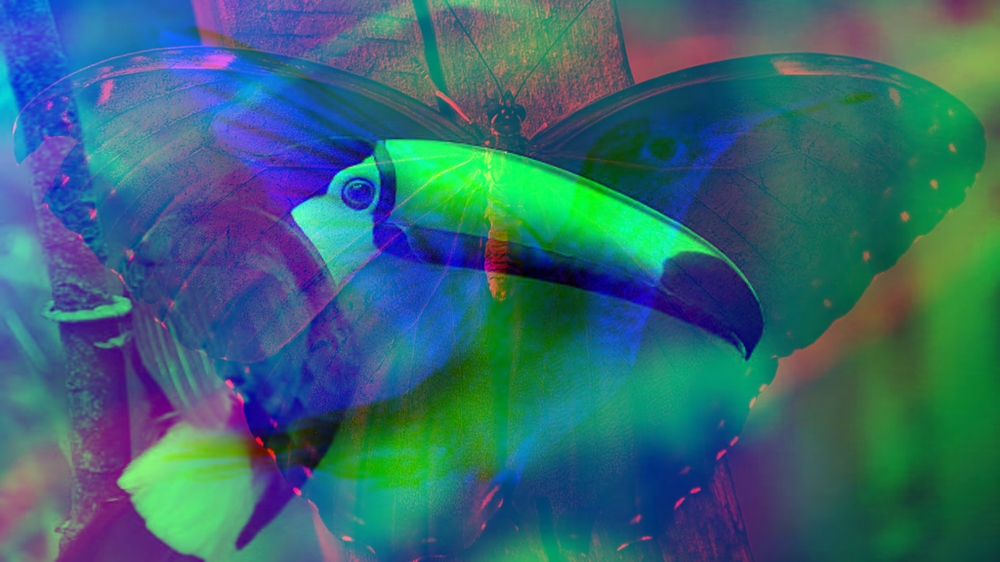

In [33]:
# Redimensionar todas las imágenes al mismo tamaño (usando el tamaño de img1 como referencia)
height, width = img1.shape[:2]
img2 = cv2.resize(img2, (width, height))
img3 = cv2.resize(img3, (width, height))


combined_img = cv2.merge([
    img3[:, :, 0],  # B (Azul) de img3
    img2[:, :, 1],  # G (Verde) de img2
    img1[:, :, 2]   # R (Rojo) de img1
])

# Mostrar resultado
cv2_imshow(combined_img)

In [34]:
negative_img = 255 - img_rojo

In [35]:
gray_img = cv2.cvtColor(img_rojo, cv2.COLOR_BGR2GRAY)

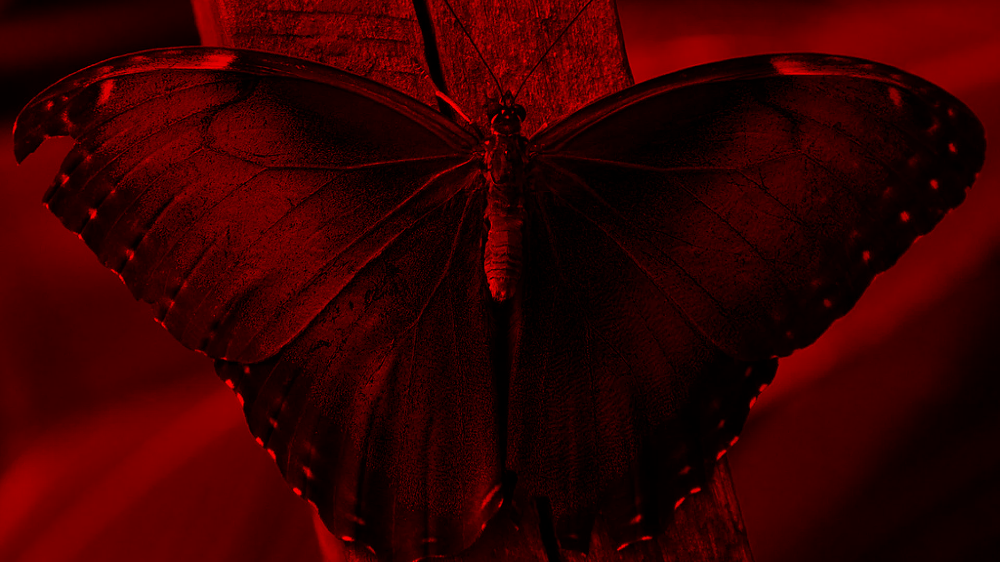

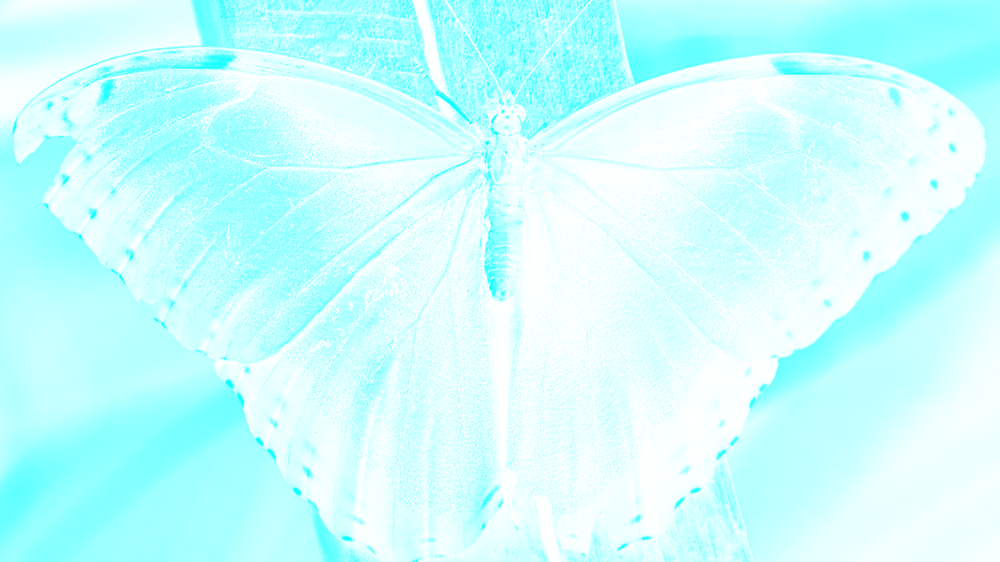

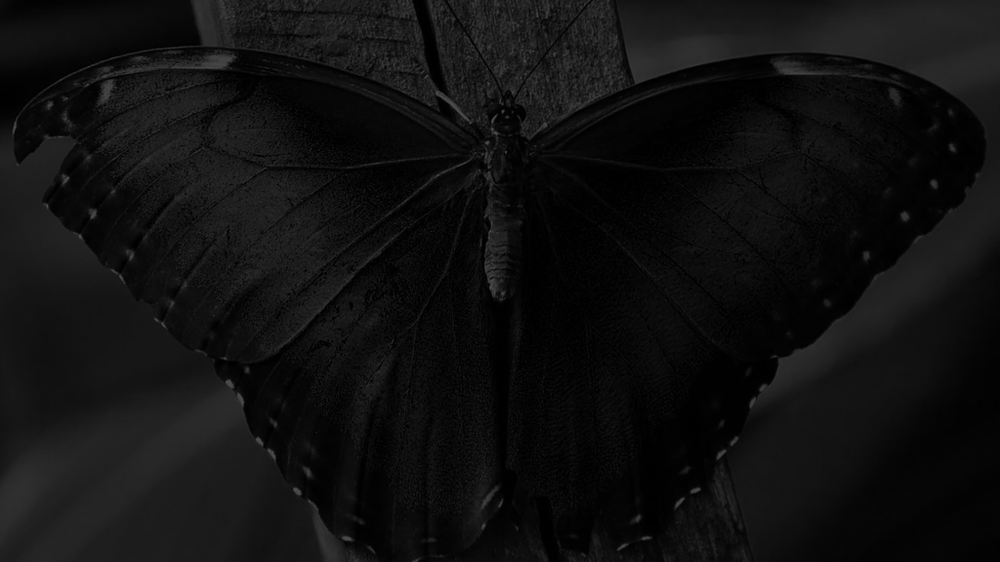

In [40]:
cv2_imshow(img_rojo)
cv2_imshow( negative_img)
cv2_imshow( gray_img)

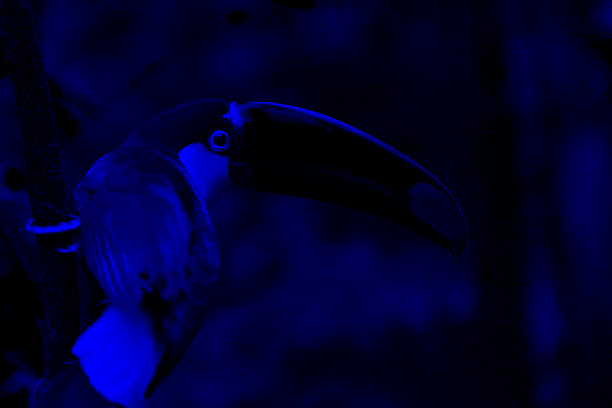

Checkbox(value=False, description='Canal Rojo (R)')

Checkbox(value=False, description='Canal Verde (G)')

Checkbox(value=True, description='Canal Azul (B)')

In [42]:
import cv2
from google.colab.patches import cv2_imshow
from google.colab import output
from IPython.display import display, HTML
import ipywidgets as widgets


img = cv2.imread('/content/pelicano.jpg')
if img is None:
    print("Error: No se pudo cargar la imagen. Sube un archivo llamado 'imagen.jpg'")
else:
    # Crear controles interactivos
    red_check = widgets.Checkbox(value=True, description='Canal Rojo (R)')
    green_check = widgets.Checkbox(value=True, description='Canal Verde (G)')
    blue_check = widgets.Checkbox(value=True, description='Canal Azul (B)')

    # Función para actualizar la visualización
    def update_image(change):
        display_img = img.copy()
        if not red_check.value:
            display_img[:, :, 2] = 0  # Apagar Rojo
        if not green_check.value:
            display_img[:, :, 1] = 0  # Apagar Verde
        if not blue_check.value:
            display_img[:, :, 0] = 0  # Apagar Azul

        output.clear()
        cv2_imshow(display_img)
        display(red_check)
        display(green_check)
        display(blue_check)

    # Configurar eventos
    red_check.observe(update_image, names='value')
    green_check.observe(update_image, names='value')
    blue_check.observe(update_image, names='value')

    # Mostrar por primera vez
    update_image(None)

In [67]:
img = cv2.imread('/content/pelicano.jpg')
img.shape

(408, 612, 3)

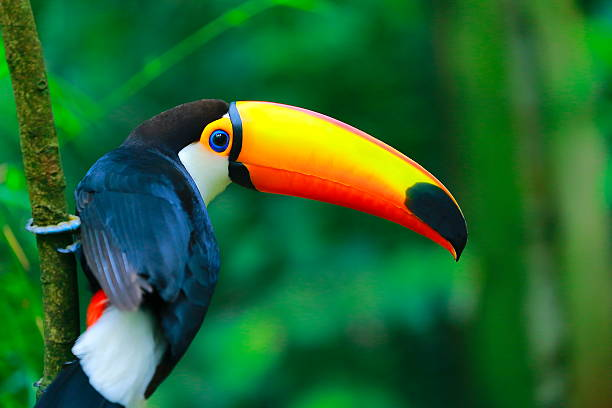

In [68]:
cv2_imshow(img)

 Imagen modificada:


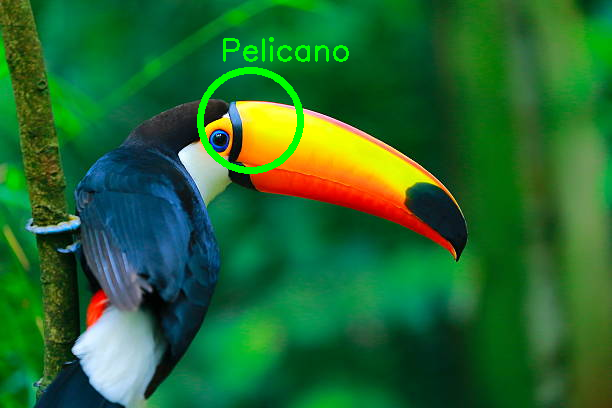

Imagen guardada como 'figura_con_anotaciones.jpg'


In [69]:
    # 2. Coordenadas MANUALES (ajústalas)
x_center = 250  # Centro X del círculo
y_center = 120  # Centro Y del círculo
radius = 50     # Radio del círculo
label = "Pelicano"

# 3. Dibujar círculo (verde)
cv2.circle(img, (x_center, y_center), radius, (0, 255, 0), 5)

# 4. Añadir texto (encima del círculo)
cv2.putText(img, label, (x_center - 30, y_center - radius - 10),
            cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

# 5. Mostrar resultado
print(" Imagen modificada:")
cv2_imshow(img)

# 6. Guardar
cv2.imwrite('/content/figura_con_anotaciones.jpg', img)
print("Imagen guardada como 'figura_con_anotaciones.jpg'")


In [70]:
img = cv2.imread('/content/pelicano.jpg')
img.shape

(408, 612, 3)

 Imagen original (escala de grises):


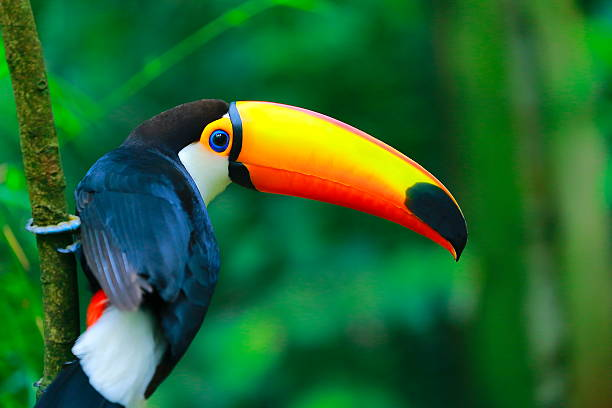


 Imagen binaria (umbral = 128):


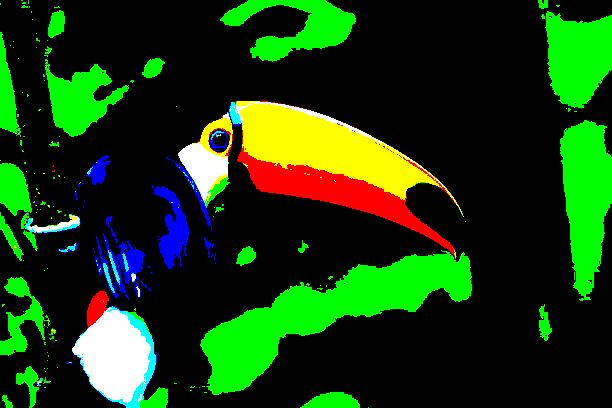

In [71]:
# 2. Aplicar umbral binario
thresh = 128  # Valor de umbral (experimenta con esto)
_, binary_img = cv2.threshold(img, thresh, 255, cv2.THRESH_BINARY)

# 3. Mostrar resultados
print(" Imagen original (escala de grises):")
cv2_imshow(img)

print(f"\n Imagen binaria (umbral = {thresh}):")
cv2_imshow(binary_img)


#Para ejecutar en Anaconda

In [ ]:
import cv2
import numpy as np

# Configuración inicial
drawing = False
mode = 'rectangle'  # 'rectangle', 'circle', 'line'
ix, iy = -1, -1
current_img = None
img_stack = []  # Para funcionalidad de deshacer

# Crear imagen en blanco
def init_img():
    return np.ones((500, 800, 3), dtype=np.uint8) * 255  # Fondo blanco

current_img = init_img()

# Función de callback para eventos del mouse
def draw_shape(event, x, y, flags, param):
    global ix, iy, drawing, current_img, img_stack

    if event == cv2.EVENT_LBUTTONDOWN:
        drawing = True
        ix, iy = x, y
        img_stack.append(current_img.copy())  # Guardar estado antes de modificar

    elif event == cv2.EVENT_MOUSEMOVE:
        if drawing:
            temp_img = img_stack[-1].copy()
            if mode == 'rectangle':
                cv2.rectangle(temp_img, (ix, iy), (x, y), (0, 255, 0), 2)
            elif mode == 'circle':
                radius = int(np.sqrt((x-ix)**2 + (y-iy)**2))
                cv2.circle(temp_img, (ix, iy), radius, (255, 0, 0), 2)
            elif mode == 'line':
                cv2.line(temp_img, (ix, iy), (x, y), (0, 0, 255), 2)
            current_img = temp_img

    elif event == cv2.EVENT_LBUTTONUP:
        drawing = False
        if mode == 'rectangle':
            cv2.rectangle(current_img, (ix, iy), (x, y), (0, 255, 0), 2)
        elif mode == 'circle':
            radius = int(np.sqrt((x-ix)**2 + (y-iy)**2))
            cv2.circle(current_img, (ix, iy), radius, (255, 0, 0), 2)
        elif mode == 'line':
            cv2.line(current_img, (ix, iy), (x, y), (0, 0, 255), 2)
        img_stack.append(current_img.copy())

# Crear ventana y configurar callback
cv2.namedWindow('Dibujo Geometrico')
cv2.setMouseCallback('Dibujo Geometrico', draw_shape)

# Instrucciones
print("Instrucciones:")
print("1- Presione 'r' para modo rectángulo")
print("2- Presione 'c' para modo círculo")
print("3- Presione 'l' para modo línea")
print("4- Presione 'u' para deshacer")
print("5- Presione 's' para guardar")
print("6- Presione 'n' para nueva imagen")
print("7- Presione ESC para salir")

while True:
    cv2.imshow('Dibujo Geometrico', current_img)
    key = cv2.waitKey(1) & 0xFF

    # Cambiar modos
    if key == ord('r'):
        mode = 'rectangle'
    elif key == ord('c'):
        mode = 'circle'
    elif key == ord('l'):
        mode = 'line'

    # Deshacer (undo)
    elif key == ord('u'):
        if len(img_stack) > 1:
            img_stack.pop()
            current_img = img_stack[-1].copy()

    # Guardar imagen
    elif key == ord('s'):
        cv2.imwrite('dibujo_geometrico.png', current_img)
        print("Imagen guardada como 'dibujo_geometrico.png'")

    # Nueva imagen
    elif key == ord('n'):
        current_img = init_img()
        img_stack = [current_img.copy()]

    # Salir
    elif key == 27:
        break

cv2.destroyAllWindows()